# Interactive Plot
The point of this notebook is to allow users to play around with the elements of the N-Body simulator, allowing for interactive plotting.

### Imports

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import ffmpeg # Writer for saving animations to .mp4 file.  Pylance and the like may think this variable is unused, but it is necessary for saving animations.
# If you are running this notebook within Jupyter Notebook AND your version of Notebook is <7, set the following line to "%matplotlib notebook" instead.  I prefer using JupyterLab, which is why I use the JupyterLab backend.
%matplotlib widget
from Definitions import *

import ffmpeg
from IPython.display import HTML
matplotlib.rcParams['animation.embed_limit'] = 2**128
plt.rcParams['figure.figsize'] = (10, 7) # Global Default plot size.  Change this if your plots are too small or too large.

## Initializing Constants
Change these if you want to change parameters  of the simulation.  Since this is an interactive notebook where you can readily change the code, I'm not going to code in hard limits preventing you from making variables nonsensical values (like negative masses, 1.5 particles, etc.), so don't blame me if you break the simulation!

In [2]:
# Constants
G = 1.0 # Gravitational constant
N = 10 # Number of bodies 
# Time 
t_start = 0.0 # Starting time
t_end = 10.0 # Ending Time
dt = 0.01 # Time step through simulation
seed = 42 # Seed for random number generation, creates reproducibility

# Softening parameter
eps = 1e-2 # Softening parameter.  Added to the denominator to prevent singularities.

# Maximum components for random mass, position, and velocity generation
M_max = 1.0
R_max = 1.0
V_max = 1.0 # All in arbitrary units.  Or, all in SI units in a universe where G = 1.0.

In [3]:
# Seed the random number generator for reproducibility
np.random.seed(seed)
M = np.random.uniform(0, M_max, N) # Random masses
R0 = np.random.uniform(-R_max, R_max, (N, 2)) # Random positions in 2D
V0 =  np.random.uniform(-V_max, V_max, (N, 2)) # Random velocities in 2D
# Convert to center-of-mass frame to prevent drift
R_com = np.sum(M[:, np.newaxis]*R0, axis=0)/np.sum(M)
V_com = np.sum(M[:, np.newaxis]*V0, axis=0)/np.sum(M)
V0 -= V_com
R0 -= R_com
#Check that the center of mass is at rest (within numerical error)
print("Center of mass velocity:", np.sum(M[:, np.newaxis]*V0, axis=0)/np.sum(M)) # should be very close to [0, 0], likely on the order of 1.e-16, or something has gone wrong

Center of mass velocity: [4.26896602e-17 0.00000000e+00]


## Run the Simulation

In [4]:
R0.shape

(10, 2)

In [5]:
t0 = time.time()
# Initialize the solver
class_args = (G, M, R0, V0, t_start, t_end, dt, eps)
compiled = True # Set to True to use the compiled solver, False to use the uncompiled solver.  Compiled solver is faster for large N, large time ranges, and/or small time steps.

if compiled:
    solver = CompiledOrbitSolver(*class_args)  # Initialize the solver.  CompiledOrbitSolver works perfectly fine within IPython.
else:
    solver = OrbitSolver(*class_args)
print("Solving...")
R, V, KE, PE = solver.solve()
t1 = time.time()
print("Motion solved after", t1-t0, "seconds")

Solving...
Motion solved after 3.6933932304382324 seconds


## Plotting

### First, the energy vs time graphs. 

There will be times where the overall energy falls quite dramatically as particles approach one another, but this is to be expected.  A nice feature of the Leapfrog method is that it is symplectic, so these fluctuations in energy are bounded by a constant profile; in plain terms, this means the energy will always bounce back to where it should be.

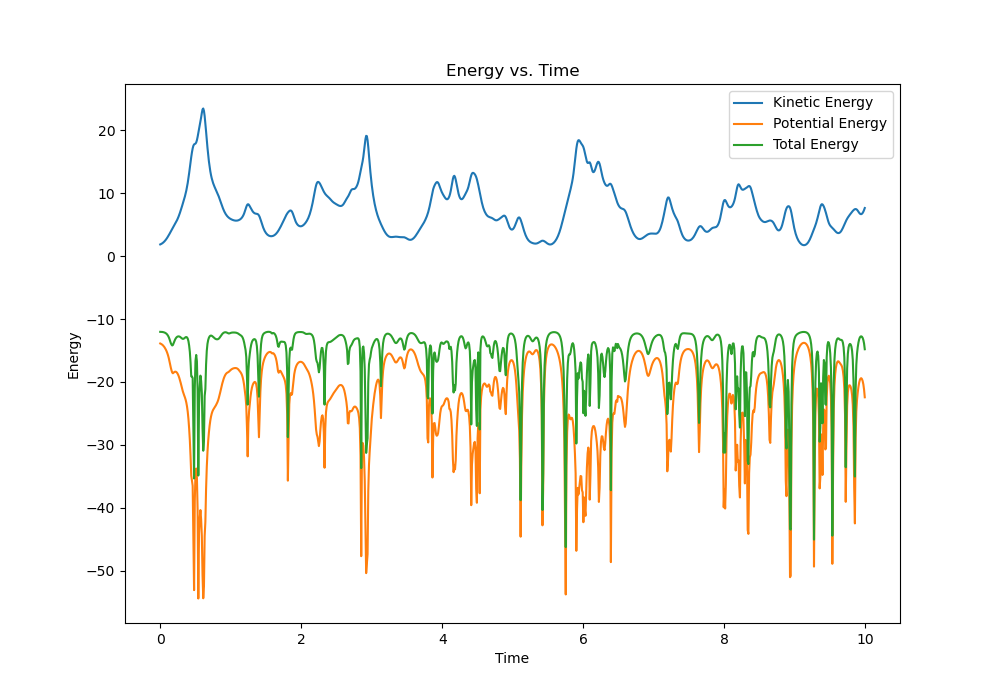

In [6]:
fig2, ax2 = plt.subplots()
ax2.set_title("Energy vs. Time")
ax2.plot(solver.T, KE, label='Kinetic Energy')
ax2.plot(solver.T, PE, label='Potential Energy')
ax2.plot(solver.T, KE + PE, label='Total Energy')
ax2.set_xlabel('Time')
ax2.set_ylabel('Energy')
ax2.legend()

### Now, the x- and y-trajectories of the center-of-mass.
Since we converted to the center-of-mass frame, these should be straight lines at $x=0$ and $y=0$.  Some error on the order of 1e-14 is to be expected.

Final center of mass position: [3.92211253e-15 1.40609068e-14]


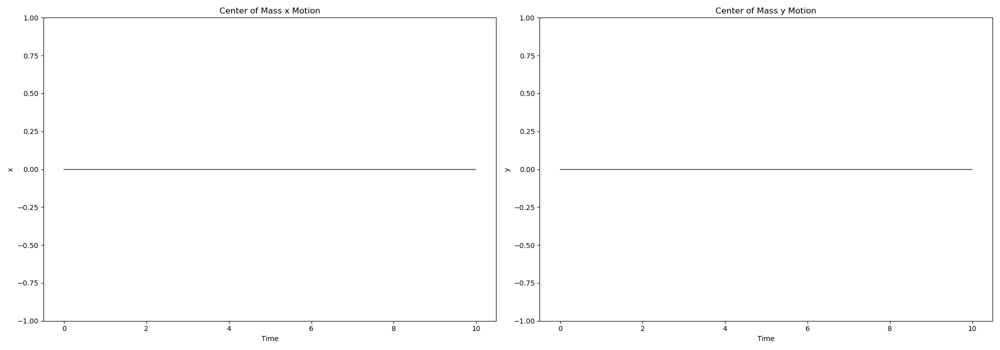

In [7]:
COM = np.zeros((2, len(solver.T)))
for i in range(len(solver.T)):
    COM[:, i] = np.sum(M[:, np.newaxis]*R[:, :, i], axis=0)/np.sum(M)
fig3 = plt.figure(figsize=(20,7))
ax31 = fig3.add_subplot(1,2,1)
ax31.set_title("Center of Mass Motion: x vs. t")
ax32 = fig3.add_subplot(1,2,2)
ax32.set_title("Center of Mass Motion: y vs. t")
ax31.plot(solver.T, COM[0])
ax31.set_xlabel('Time')
ax31.set_ylabel('x')
ax31.set_title('Center of Mass x Motion')
ax31.set_ylim(-1, 1)
ax32.plot(solver.T, COM[1])
ax32.set_xlabel('Time')
ax32.set_ylabel('y')
ax32.set_title('Center of Mass y Motion')
ax32.set_ylim(-1, 1)
fig3.tight_layout()
print("Final center of mass position:", COM[:, -1])

## Animation

### Setup Animation

In [8]:
%%capture 
fig1, ax1 = plt.subplots()
trails = True # Set to True to show trails, False to show only the current position
ax1.set_title(rf"{N}-Body Simulation: $t_0$ = {solver.t_start}, $t_f$ = {solver.t_end}, $\Delta t$ = {solver.dt}, $\epsilon$ = {solver.eps}, $G$ = {solver.G}")
x_min = np.min(R[:, 0, :])
x_max = np.max(R[:, 0, :])
ax1.set_xlim(x_min, x_max)
y_min = np.min(R[:, 1, :])
y_max = np.max(R[:, 1, :])
ax1.set_ylim(y_min, y_max)
Marker_sizes = M.copy()
for i in range(len(M)):
    Marker_sizes[i] = max(5 * M[i] / np.max(M),0.5) # Scale the marker size based on the mass of the body, with a minimum size of 0.5 for visibility
if trails:
    lines = [ax1.plot([], [], 'o--', markersize=Marker_sizes[i], markevery=[-1])[0] for i in range(N)] 
else:
    lines = [ax1.plot([], [], 'o', markersize = Marker_sizes[i])[0] for i in range(N)]
def init():
    for line in lines:
        line.set_data([], [])
    return lines
def animate(i):
    for j, line in enumerate(lines):
        if trails:
            line.set_data([R[j, 0, max(0, i-10):i]], [R[j, 1, max(0, i-10):i]])
        else:   
            line.set_data([R[j, 0, i]], [R[j, 1, i]])
    return lines
anim = animation.FuncAnimation(fig1, animate, frames=len(solver.T), init_func=init, blit=True, interval=dt*1000, repeat=True) # Set the interval to the time step in milliseconds

Now, if everything worked, the following cell should produce a nice, interactive plot:

In [9]:
HTML(anim.to_jshtml())